# Query-by-humming model tutorial


In [2]:
# move working directory to /qbh_project
%cd ..
%pwd

/home/svcapp/userdata/dev/qbh_project


'/home/svcapp/userdata/dev/qbh_project'

In [3]:
%load_ext autoreload
%autoreload 2

import pickle
import pandas as pd
import numpy as np
from pathlib import Path
import IPython.display as ipd
from pydub import AudioSegment
import matplotlib.pyplot as plt
import random
import utils.monitoring as monitoring

from utils.sampling_utils import downsample_contour_array


import builtins
from IPython.lib import deepreload
builtins.reload = deepreload.reload


## 0. Metadata of DB

Meta data is saved as a list of dictionary.
Each item in the list represents a single track.


- db_metadata: database consists of music100k + music120k
- humm_test_meta: database consists of 100 pieces selected by FLO

Caution: 'track_id' is the one corresponds to actual file name, not a 'song_id'.
Since the provided metadata for each dataset is different, dictionary key for each metadata set is different from each other.


Belows are the list of genre name and the corresponding id. + sign represents that the genre was included during the QbH model training

- 해외 메탈 18
- 국내 발라드 4 +
- 해외 힙합 14
- 기타 30
- 클래식 20
- 재즈 22
- 국내 락/메탈 12 + 
- 해외 팝 13 + 
- 월드뮤직 26
- 해외 락 17 + 
- J-POP 25
- 뉴에이지 21
- 국내 알앤비 7 + 
- CCM 28
- 해외 알앤비 15 + 
- 맘/태교 24
- OST/BGM 19
- 국내 댄스/일렉 5
- 해외 일렉트로닉 16
- 트로트 8
- 국내 포크/블루스 11 + 
- 키즈 23
- 국내 인디 9 +
- 종교음악 29
- 국악 27
- 국내 팝/어쿠스틱 10 +
- 국내 힙합 6

In [4]:
with open("data/flo_metadata_220k.dat", 'rb') as f:
    db_metadata = pickle.load(f)

humm_test_meta = pd.read_csv('data/flo_test_list.csv').to_dict('records')

# print first track as an example
print("1. db_metadata example:", db_metadata[0])
print("2. flo_test_metadata example:", humm_test_meta[0])

1. db_metadata example: {'song_id': 427675419, 'artist_id_basket': [80141499], 'artist_name_basket': ['AKMU (악동뮤지션)'], 'album_id': 403299537, 'album_name': '항해', 'track_id': 427675419, 'track_name': '어떻게 이별까지 사랑하겠어, 널 사랑하는 거지', 'label_name_basket': ['YG Entertainment'], 'genre_id_basket': [4], 'genre_name_basket': ['국내 발라드'], 'publish_date': 20190925, 'play_count': 13161405}
2. flo_test_metadata example: {'곡명': 'You Give Me Something', '아티스트명': 'James Morrison', '해당 요건': 'CF', '비고': 'KTX 광고', 'url': 'https://www.music-flo.com/detail/track/hdnzyzeh/details', 'track id': 80269648}


## 1. Melody data from audio file

"Melody" of music is extracted using singing voice estimation model.
The result is saved in txt format.

This section demonstrates how the result is formatted

In [5]:
# define dataset path
dataset_dir = Path('/home/svcapp/t2meta/flo_new_music/music_100k/')
# define target genre
# selected_genres = [4]
selected_genres = [4, 12, 13, 17, 10, 7,15, 11, 9]

In [6]:
from utils.melody_utils import MelodyLoader
from utils.data_utils import get_song_ids_of_selected_genre, song_id_to_pitch_txt_path

### Get a list of song id and corresponding pitch path

In [7]:
song_ids = get_song_ids_of_selected_genre(db_metadata, selected_genres)
with open('data/humm_db_ids.dat', 'rb') as f:
    humm_ids = pickle.load(f)
song_ids += humm_ids
melody_loader = MelodyLoader(dataset_dir)
melody_loader.check_txt_exists(song_ids, make_txt=False) # Set make_txt=True to make txt


/home/svcapp/.local/lib/python3.6/site-packages/torch/nn/modules/rnn.py:51: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


Check passed: Every song has corresponding txt


#### The following shows the example of windowed melody.

- melody_of_piece: list of dict
    - 'contour': numpy array of contour
    - 'song_id': 'track_id' of the song
    - 'frame_pos': slice position in 10ms

In [8]:
# can select any index < len(song_ids)
index = 1
target_song_id = song_ids[index]
melodies_of_piece = melody_loader(target_song_id)
print(melodies_of_piece[0])

{'contour': array([[0., 0.],
       [0., 0.],
       [0., 0.],
       ...,
       [0., 0.],
       [0., 0.],
       [0., 0.]]), 'song_id': 433090157, 'frame_pos': (4000, 6000)}


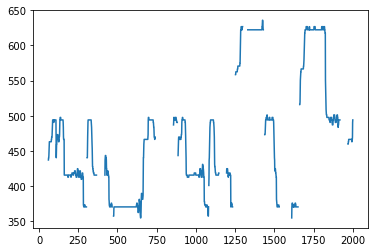

In [9]:
# Monitor data with plot graph and audio
melody_idx = random.randint(0, len(melodies_of_piece)-1)
selected_melody = melodies_of_piece[melody_idx]

# The contour was converted into log scale and then normalized with mean/std
# Therefore, this process 
contour_in_hz_scale = np.copy(selected_melody['contour']) 
contour_in_hz_scale[:,0] = monitoring.normalized_vec_to_orig(selected_melody['contour'])
monitoring.plot_contour_with_voice_only(contour_in_hz_scale)

orig_audio, contour_audio = monitoring.get_audio_and_sine_from_contour_data(selected_melody, dataset_dir)
ipd.display(ipd.Audio(orig_audio, rate=44100))
ipd.display(ipd.Audio(contour_audio, rate=44100))
ipd.display(ipd.Audio((orig_audio+contour_audio)/2, rate=44100))


## 2. Humming data from HummingDB
- HummingDB consists of humming audio and metadata
- Data is available on [Google Drive](https://drive.google.com/drive/folders/1qrc5S2plEEQtMU_8RXmbG4q-enzqhadE?usp=sharing)
- "Spec.xlsx" includes metadata of humming audio
- 900 songs were selected from flo_metadata.dat (original music_100k dataset)
- 100 songs were selected by FLO
- Since we don't have detailed metadata for 100 songs selected by FLO, meta format is slightly different.
- fundamental frequency (melody contour), which is saved in *.f0.csv, was calculated by [crepe library](https://github.com/marl/crepe).

In [10]:
humming_data_dir = Path('/home/svcapp/userdata/humming_db')

In [11]:
import utils.humming_data_utils as humming

selected_100, selected_900 = humming.load_meta_from_excel(xlsx_path=humming_data_dir/"Spec.xlsx", meta_path="data/flo_metadata_220k.dat", meta_100_path='data/meta_100.dat')
humming_db = humming.HummingDB(humming_data_dir, dataset_dir, selected_100, selected_900)


In [12]:
# Print example
humming_db[0]

{'humm': array([[0., 0.],
        [0., 0.],
        [0., 0.],
        ...,
        [0., 0.],
        [0., 0.],
        [0., 0.]]), 'orig': array([[-1.19150787,  1.        ],
        [-1.19150787,  1.        ],
        [-1.19150787,  1.        ],
        ...,
        [ 0.66531312,  1.        ],
        [ 0.66531312,  1.        ],
        [ 0.66531312,  1.        ]]), 'meta': {'path': '/home/svcapp/userdata/humming_db/100/0~24/01_P/100_0_A_105-125_(PF_KRJ).wav',
  'pitch_path': '/home/svcapp/userdata/humming_db/100/0~24/01_P/100_0_A_105-125_(PF_KRJ).f0.csv',
  'song_group': '100',
  'song_idx': '0',
  'humming_type': 'A',
  'time_stamp': '105-125',
  'singer_group': 'P',
  'singer_id': 'KRJ',
  'singer_gender': 'F',
  'track_id': 80269648}}

- 'humm': array of humming melody. Time resolution is 10 ms
- 'orig': array of original melody, extracted from original recording by automatic singing voice estimator. Time resolution is 10 ms. The slice position was selected based on 'meta'-'time_stamp'
- 'meta': metadata of humming sample.
    - 'path': path to humming audio
    - 'pitch_path': path to f0 curve extracted from humming audio by crepe algorithm.
    - 'song_group': '100' or '900',
    - 'song_idx': song idx in humming list
    - 'humming_type': 'A' for mouth-closed humming, 'B' for humming with A vowel, 'C' for singing with lyric, 'D' for freely selected by singer
    - 'time_stamp': str(A-B) that represents time stamp of humming in original audio, in seconds. Notated by the singer.
    - 'singer_group': 'P' for professional, 'N' for non-professional
    - 'singer_id': initial of singer name
    - 'singer_gender': 'M' or 'F'
    - 'track_id': track_id of the corresponding original song
    


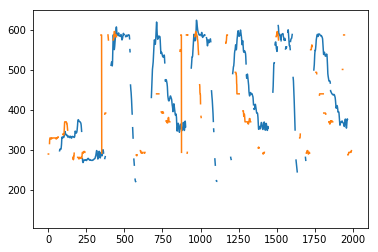

In [13]:
# Monitor data with plot graph and audio
melody_idx = random.randint(0, len(humming_db)-1)
selected_humm_pair = humming_db[melody_idx]

# The contour was converted into log scale and then normalized with mean/std
# Therefore, this process 
contour_in_hz_scale = np.copy(selected_humm_pair['humm']) 
contour_in_hz_scale[:,0] = monitoring.normalized_vec_to_orig(selected_humm_pair['humm'])
monitoring.plot_contour_with_voice_only(contour_in_hz_scale)

orig_contour_in_hz_scale = np.copy(selected_humm_pair['orig'])
orig_contour_in_hz_scale[:,0] = monitoring.normalized_vec_to_orig(selected_humm_pair['orig'])
monitoring.plot_contour_with_voice_only(orig_contour_in_hz_scale)


humm_audio, orig_audio, humm_contour_audio, orig_contour_audio = monitoring.get_audio_and_sine_from_humming_pair(selected_humm_pair, dataset_dir)
ipd.display(ipd.Audio(humm_audio, rate=44100))
ipd.display(ipd.Audio(orig_audio, rate=44100))
ipd.display(ipd.Audio(humm_contour_audio, rate=44100))
ipd.display(ipd.Audio(orig_contour_audio, rate=44100))



## 3. QbH Model

QbH model takes melody input and embed it into a 512-dim vector.

Pre-trained weights is available on [Google Drive](https://drive.google.com/drive/folders/1qrc5S2plEEQtMU_8RXmbG4q-enzqhadE?usp=sharing)

- Input is a tensor of B x N x 2.
- B is number of batch.
- N is number of frames in 100 ms. (The original txt or csv file has melody in 10 ms. Therefore, the melody has to be downsampled before feeding it into QbH model)
- Output is a tensor of B x 512

In [9]:
from test_qbh import load_model
from model import hparams
import torch
# model_dir = Path('/home/svcapp/t2meta/qbh_model')
# model_id = 485391
# ckpt_dir = next(model_dir.glob(f"worker_{model_id}*"))
ckpt_dir = Path('weights/contour_model')
device = 'cuda'

encoder_model, hparams = load_model(ckpt_dir, device=device)

Loading checkpoint 'weights/contour_model/checkpoint_best.pt'
Loading checkpoint 'weights/contour_model/checkpoint_best.pt'
Loaded checkpoint 'weights/contour_model/checkpoint_best.pt' from iteration 300001


/home/svcapp/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:541: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/svcapp/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:542: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/svcapp/.local/lib/python3.6/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:543: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/svcapp/.local/lib/python3.6/site-packages/tensorboard/compat/ten

In [10]:
# contour has to be downsampled from 10ms resolution to 100ms resolution (10-to-1 downsample)
contour = downsample_contour_array(selected_melody['contour'])

# change contour as a tensor of Batch X Length X 2
contour_tensor = torch.Tensor(contour).unsqueeze(0).to(device)

# get_embedding:
contour_embedding = encoder_model(contour_tensor)
print(contour_embedding.shape, contour_embedding)

NameError: name 'selected_melody' is not defined

## 4 Training
### 4-1 Training Dataset and Data Augmentation


- humming_db_contour_pairs.dat was generated by humming_data_utils.py

In [12]:
from train import prepare_dataloaders, prepare_entire_loader, prepare_humming_db_loaders
from hparams import HParams

# Pre-defined hparams can be loaded from load_model.
# Otherwise, you can define new one with following 
# hparams = HParams()
hparams.meta_path = 'data/flo_metadata_220k.dat'
hparams.humming_path = '/home/svcapp/userdata/flo_melody/humming_db_contour_pairs.dat'
hparams.data_dir = dataset_dir
hparams.batch_size = 64
hparams.valid_batch_size = 128
hparams.end_to_end = False

# Load entire_loader, which includes every song in the database for selected genre
# num_song_limit is just for testing with small dataset
# add_humm=True add songs that are included in HummingDB to the entire_loader. If not, we cannot search song with a humming query because the song is not included in the dataset
entire_loader = prepare_entire_loader(hparams, num_song_limit=1000, add_humm=True)
train_loader, val_loader = prepare_dataloaders(hparams, entire_loader)
humm_train_loader, humm_val_loader = prepare_humming_db_loaders(hparams)

- train_loader: 
    - load tensor from MelodyDB. 
    - Anchor is a melody from a song in MelodyDB
    - Positive samples are generated by melody augmentation of anchor melody.
    - Negative samples are from other piece of music (with different track_id)
- humm_train_loader: 
    - load tensor from HummingDB. 
    - Anchor is a f0 contour from a humming in HummingDB
    - Positive samples are original melody of the same song and its augmentation from Melody DB
    - Negative samples are from other piece of music (with different track_id)


- Batch Structure:
    - (Num Batch X (1 + num_positive_samples + num_negative_samples )) X max_length X 2
    - Can be resahped as Num Batch X (1 + num_positive_samples + num_negative_samples ) X max_length X 2
    - Order of sample in batch is as below:
        - 0th melody anchor
        - 0th melody 0th positive sample
        - 0th melody 1st positive sample
        - ...
        - 0th melody (n_pos)th positive sample
        - 0th melody 0th negative sample
        - 0th melody 1st neagtive sample
        - ...
        - 0th melody (n_neg)th negative sample
        - 1st melody anchor
        - ...


In [23]:
train_loader_sample = next(iter(train_loader))
humm_loader_sample = next(iter(humm_train_loader))

print(train_loader_sample.shape) # (Num_Batch X (1 + num_pos + num_neg)) X max_length X 2
print(humm_loader_sample.shape) # (Num_Batch X (1 + num_pos + num_neg)) X max_length X 2

torch.Size([1088, 314, 2])
torch.Size([1088, 586, 2])


### Monitoring data augmentation
- Anchor sample is an automatically-extracted melody 
- Positive samples are augmented version of anchor sample
    - pitch shift
    - tempo change
    - voice fill in
    - pitch noise
    - tempo noise
    - masking
- Negative samples are melody from songs with different track_id

#### The plot below shows example of Anchor, Positive sample, Negative sample

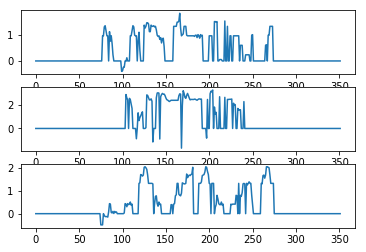

In [22]:
example_id = 0
example_of_single_pair = train_loader_sample.view(-1, 1+train_loader.dataset.num_aug_samples+train_loader.dataset.num_neg_samples, train_loader_sample.shape[1], train_loader_sample.shape[2])[example_id]
anchor = example_of_single_pair[0]
first_pos = example_of_single_pair[1]
first_neg = example_of_single_pair[1+train_loader.dataset.num_aug_samples]

fig = plt.figure()
fig.add_subplot(3,1,1)
plt.plot(anchor[:,0])
fig.add_subplot(3,1,2)
plt.plot(first_pos[:,0])
fig.add_subplot(3,1,3)
plt.plot(first_neg[:,0])

anchor_wav = monitoring.generate_sine_wav(monitoring.normalized_vec_to_orig(anchor.numpy()), frame_rate=10, sr=44100)
pos_wav = monitoring.generate_sine_wav(monitoring.normalized_vec_to_orig(first_pos.numpy()), frame_rate=10, sr=44100)
neg_wav = monitoring.generate_sine_wav(monitoring.normalized_vec_to_orig(first_neg.numpy()), frame_rate=10, sr=44100)

ipd.display(ipd.Audio(anchor_wav, rate=44100))
ipd.display(ipd.Audio(pos_wav, rate=44100))
ipd.display(ipd.Audio(neg_wav, rate=44100))

### Visualization Anchor-Pos-Neg pair in t-SNE 

- Each circle represents anchor embedding
- Green line represents a distance between the anchor and a positive sample
- Red line represents a distance between the anchor and a negative sample

In [23]:
from sklearn.manifold import TSNE
batch =train_loader_sample.cuda()
with torch.no_grad():
    anchor, pos, neg = encoder_model(batch, siamese=True)

embed_cat = torch.cat([anchor, pos, neg], dim=1)
tsne_embedded = TSNE(n_components=2).fit_transform(embed_cat.view(-1,512).cpu().numpy())


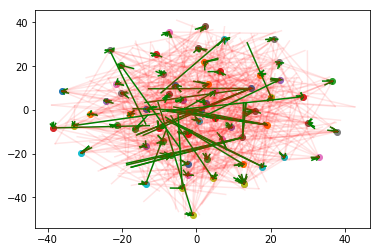

In [24]:
num_pos_samples = pos.shape[1]
num_neg_samples = neg.shape[1]
num_emb_per_melody = 1+num_pos_samples+num_neg_samples

for i in range(anchor.shape[0]):
    anchor_id = i*num_emb_per_melody
    plt.scatter(tsne_embedded[anchor_id,0], tsne_embedded[anchor_id,1])
    for j in range(num_pos_samples):
        plt.plot( [tsne_embedded[anchor_id,0], tsne_embedded[anchor_id+j+1,0]], [tsne_embedded[anchor_id,1], tsne_embedded[anchor_id+j+1,1]], c='g' )
    for j in range(num_neg_samples):
        plt.plot( [tsne_embedded[anchor_id,0], tsne_embedded[anchor_id+j+num_pos_samples+1,0]], [tsne_embedded[anchor_id,1], tsne_embedded[anchor_id+j+num_pos_samples+1,1]], alpha=0.1, c='r')

### Train Loop for jupyter
(The full train loop is in train.py)


In [25]:
from model.loss_function import SiameseLoss
from torch.optim.lr_scheduler import StepLR

target_iter = 100
iteration = 0

encoder_model.train()
optimizer = torch.optim.Adam(encoder_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
scheduler = StepLR(optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
criterion = SiameseLoss(margin=hparams.loss_margin, use_euclid=hparams.use_euclid, use_elementwise=hparams.use_elementwise_loss)
iterative_loader = iter(train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    encoder_model.zero_grad()
    batch = batch.cuda()
    anchor, pos, neg = encoder_model(batch, siamese=True)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(encoder_model.parameters(), hparams.grad_clip_thresh)
    optimizer.step()
    scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1


iter_0 Loss: 0.11304323375225067
iter_1 Loss: 0.07490384578704834
iter_2 Loss: 0.04422435909509659
iter_3 Loss: 0.035269953310489655
iter_4 Loss: 0.0364132821559906
iter_5 Loss: 0.03731808811426163
iter_6 Loss: 0.038462646305561066
iter_7 Loss: 0.03745736926794052
iter_8 Loss: 0.03061635047197342
iter_9 Loss: 0.03397999331355095
iter_10 Loss: 0.03265179321169853
iter_11 Loss: 0.03977494686841965
iter_12 Loss: 0.03222281113266945
iter_13 Loss: 0.03446051478385925
iter_14 Loss: 0.036462850868701935
iter_15 Loss: 0.03102683275938034
iter_16 Loss: 0.030070357024669647
iter_17 Loss: 0.03015592321753502
iter_18 Loss: 0.03291623666882515
iter_19 Loss: 0.0235800389200449
iter_20 Loss: 0.028048012405633926
iter_21 Loss: 0.02342425100505352
iter_22 Loss: 0.029804132878780365
iter_23 Loss: 0.023957498371601105
iter_24 Loss: 0.024645980447530746
iter_25 Loss: 0.025556698441505432
iter_26 Loss: 0.01983114890754223
iter_27 Loss: 0.028448911383748055
iter_28 Loss: 0.02269078977406025
iter_29 Loss: 0.

Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/queues.py", line 234, in _feed
    obj = _ForkingPickler.dumps(obj)
  File "/usr/lib/python3.6/multiprocessing/reduction.py", line 51, in dumps
    cls(buf, protocol).dump(obj)
  File "/home/svcapp/.local/lib/python3.6/site-packages/torch/multiprocessing/reductions.py", line 323, in reduce_storage
    fd, size = storage._share_fd_()
RuntimeError: unable to write to file </torch_19496_2470819062>


In [21]:
# Train with 

### Validation by data augmentation
- One of simple validation processes is to sample a melody from validset and search this melody by feeding augmented versions of it.
- The score shows how the NN is robust to melody augmentation

In [13]:
from model.validation import get_contour_embeddings, cal_mrr_of_loader

encoder_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(encoder_model, entire_loader)
    valid_score = cal_mrr_of_loader(encoder_model, val_loader, total_embs, total_song_ids)
print(valid_score)


0.9994929797119565


### Fine Tuning with humming data

In [16]:
from itertools import cycle 

from model.loss_function import SiameseLoss
from torch.optim.lr_scheduler import StepLR

target_iter = 20
iteration = 0

criterion = SiameseLoss(margin=hparams.loss_margin, use_euclid=hparams.use_euclid, use_elementwise=hparams.use_elementwise_loss)
encoder_model.train()
fine_optimizer = torch.optim.Adam(encoder_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
fine_scheduler = StepLR(fine_optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
iterative_loader = cycle(humm_train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    encoder_model.zero_grad()
    batch = batch.cuda()
    anchor, pos, neg = encoder_model(batch, siamese=True)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(encoder_model.parameters(), hparams.grad_clip_thresh)
    fine_optimizer.step()
    fine_scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1

iter_0 Loss: 0.06811125576496124
iter_1 Loss: 0.059182651340961456
iter_2 Loss: 0.04823294281959534
iter_3 Loss: 0.038253672420978546
iter_4 Loss: 0.03870408609509468
iter_5 Loss: 0.052108798176050186
iter_6 Loss: 0.041714176535606384
iter_7 Loss: 0.06952624022960663
iter_8 Loss: 0.053610555827617645
iter_9 Loss: 0.06296252459287643
iter_10 Loss: 0.046662092208862305
iter_11 Loss: 0.04017683118581772
iter_12 Loss: 0.06732369214296341
iter_13 Loss: 0.04625362530350685
iter_14 Loss: 0.06127839908003807
iter_15 Loss: 0.023589182645082474
iter_16 Loss: 0.025266099721193314
iter_17 Loss: 0.024780578911304474
iter_18 Loss: 0.017818231135606766
iter_19 Loss: 0.02178312838077545


### Validation with humming data

In [24]:
encoder_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(encoder_model, entire_loader)
    valid_score = cal_mrr_of_loader(encoder_model, humm_val_loader, total_embs, total_song_ids)
print(valid_score)

0.9148200452327728


### Test with humming data

In [17]:
from test_qbh import evaluate, prepare_humming_testset, get_index_by_id, convert_result_to_dict, convert_result_to_rec_title

humm_test_loader = prepare_humming_testset('/home/svcapp/userdata/flo_melody/humming_db_contour_pairs.dat', num_workers=4)

total_slice_pos = np.asarray([x['frame_pos'] for x in entire_loader.dataset.contours]) # Here we also record exact slice position

meta_in_song_key = {x['track_id']: x for x in db_metadata}
for song in selected_100.to_dict('records'):
    meta_in_song_key[song['track_id']] = song
for song in selected_900.to_dict('records'):
    meta_in_song_key[song['track_id']] = song
    
flo_test_list = pd.read_csv('data/flo_test_list.csv')
flo_test_meta = {x['track id']: x for x in flo_test_list.to_dict('records')}
humm_meta = [x['meta'] for x in humm_test_loader.dataset.contours]

#### During the test process, the search results are listed in a track-wise, not a melody-wise. 
Therefore, here we group melodies by track

In [18]:
# Group melodies by track
unique_ids, index_by_id = get_index_by_id(total_song_ids)

# calculate accuracy
topk_score, mrr_score, total_recommends, total_test_ids, total_rank, total_rec_slices, total_corresp_similarity = evaluate(encoder_model, humm_test_loader, total_embs, total_song_ids, unique_ids, index_by_id, total_slice_pos, top_k=10)

Top 10 accuracy: 0.728
MRR score:  0.6394959895492954


In [19]:
# make result readable
eval_out = convert_result_to_dict(total_test_ids, total_rank, meta_in_song_key)
detailed_eval_out = convert_result_to_rec_title(total_test_ids, total_recommends, total_rank, total_corresp_similarity, meta_in_song_key, humm_meta)

In [20]:
dataframe = pd.DataFrame(detailed_eval_out).transpose()
dataframe.insert(1, 'Class', [flo_test_meta[x]['해당 요건'] for x in dataframe[0].values])
dataframe = dataframe.sort_values('Class')
sorted_keys = dataframe.to_dict()[0].keys()
dataframe = dataframe.drop(columns=[0])
dataframe

,Class,1,2,3,4,5
민수 - 민수는 혼란스럽다,CF,Rec rank: 2\nSimilarity with Orig: 0.7473\n위키미...,Rec rank: 1\nSimilarity with Orig: 0.8544\n민수 ...,Rec rank: 3\nSimilarity with Orig: 0.6472\n위키미...,Rec rank: 1\nSimilarity with Orig: 0.6181\n민수 ...,Rec rank: 3\nSimilarity with Orig: 0.6381\nNCT...
Betty Who - Taste,CF,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...
Chantal Chamberland - La Mer,CF,Rec rank: 1\nSimilarity with Orig: 0.8025\nCha...,Rec rank: 1\nSimilarity with Orig: 0.7647\nCha...,Rec rank: 31\nSimilarity with Orig: 0.5899\n김연...,Rec rank: 1\nSimilarity with Orig: 0.7798\nCha...,Rec rank: 1\nSimilarity with Orig: 0.6886\nCha...
James Blake - Are You Even Real?,CF,Rec rank: 165\nSimilarity with Orig: 0.4750\nH...,Rec rank: 61\nSimilarity with Orig: 0.5853\nTa...,Rec rank: 63\nSimilarity with Orig: 0.5548\nZA...,Rec rank: 70\nSimilarity with Orig: 0.5181\n유리...,Rec rank: 3\nSimilarity with Orig: 0.6039\n핑클 ...
김현철 - Drive,CF,Rec rank: 1\nSimilarity with Orig: 0.7356\n김현철...,Rec rank: 1\nSimilarity with Orig: 0.9245\n김현철...,Rec rank: 1\nSimilarity with Orig: 0.8415\n김현철...,Rec rank: 5\nSimilarity with Orig: 0.6970\n비비 ...,Rec rank: 1\nSimilarity with Orig: 0.7506\n김현철...
HONNE - Warm On A Cold Night,CF,Rec rank: 539\nSimilarity with Orig: 0.2405\nL...,Rec rank: 1\nSimilarity with Orig: 0.7733\nHON...,Rec rank: 31\nSimilarity with Orig: 0.5665\nOz...,Rec rank: 1\nSimilarity with Orig: 0.7952\nHON...,Rec rank: 1\nSimilarity with Orig: 0.8237\nHON...
"Pawl, Discrete - Type Like That",SNS,Rec rank: 75\nSimilarity with Orig: 0.6173\nSt...,Rec rank: 1537\nSimilarity with Orig: 0.0994\n...,Rec rank: 1\nSimilarity with Orig: 0.7499\nPaw...,Rec rank: 1027\nSimilarity with Orig: 0.2619\n...,Rec rank: 856\nSimilarity with Orig: 0.2913\nC...
Maluma - Hawai,SNS,Rec rank: 10\nSimilarity with Orig: 0.6288\nBr...,Rec rank: 1\nSimilarity with Orig: 0.8951\nMal...,Rec rank: 3\nSimilarity with Orig: 0.7803\nMar...,Rec rank: 1\nSimilarity with Orig: 0.7703\nMal...,Rec rank: 10\nSimilarity with Orig: 0.7758\n박재...
Jawsh 685 & Jason Derulo - Savage Love (Laxed - Siren Beat),SNS,Rec rank: 1\nSimilarity with Orig: 0.8114\nJaw...,Rec rank: 1\nSimilarity with Orig: 0.8060\nJaw...,Rec rank: 11\nSimilarity with Orig: 0.5851\nPR...,Rec rank: 1\nSimilarity with Orig: 0.7908\nJaw...,Rec rank: 3\nSimilarity with Orig: 0.6131\nAle...
Bag Raiders - Shooting Stars,SNS,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...,Rec rank: 1825\nSimilarity with Orig: -1.0000\...


# 5. End-to-end Model

In [27]:
# model_id = 484078
# model_dir = Path('/home/svcapp/t2meta/end-to-end-qbh/')
# ckpt_dir = next(model_dir.glob(f"worker_{model_id}*"))
ckpt_dir = ('weights/end_to_end_model/')
end_to_end_model, hparams = load_model(ckpt_dir)

NameError: name 'load_model' is not defined

In [30]:
hparams.meta_path = 'data/flo_metadata_220k.dat'
hparams.humming_path = '/home/svcapp/userdata/flo_melody/humming_db_contour_pairs.dat'
hparams.data_dir = dataset_dir
hparams.batch_size = 2
hparams.valid_batch_size = 4

# Load entire_loader, which includes every song in the database for selected genre
# num_song_limit is just for testing with small dataset
# add_humm=True add songs that are included in HummingDB to the entire_loader. If not, we cannot search song with a humming query because the song is not included in the dataset
entire_loader = prepare_entire_loader(hparams, num_song_limit=1000, add_humm=True)


In [31]:
train_loader, val_loader = prepare_dataloaders(hparams, entire_loader)
humm_train_loader, humm_val_loader = prepare_humming_db_loaders(hparams)

In [32]:
target_iter = 30
iteration = 0

encoder_model.train()
optimizer = torch.optim.Adam(end_to_end_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
scheduler = StepLR(optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
criterion = SiameseLoss(margin=hparams.loss_margin, use_euclid=hparams.use_euclid, use_elementwise=hparams.use_elementwise_loss)
iterative_loader = iter(train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    end_to_end_model.zero_grad()
    audio_anchor, melody = batch
    audio_anchor = audio_anchor.to('cuda')
    melody = melody.to('cuda')
    anchor, pos, neg = end_to_end_model( (audio_anchor, melody), siamese=True, num_pos=train_loader.dataset.num_aug_samples)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(end_to_end_model.parameters(), hparams.grad_clip_thresh)
    optimizer.step()
    scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1


iter_0 Loss: 0.05164394527673721
iter_1 Loss: 0.029582155868411064
iter_2 Loss: 0.15551987290382385
iter_3 Loss: 0.03489955887198448
iter_4 Loss: 0.03886627033352852
iter_5 Loss: 0.07162514328956604
iter_6 Loss: 0.055320583283901215
iter_7 Loss: 0.07393311709165573
iter_8 Loss: 0.025722987949848175
iter_9 Loss: 0.10203316807746887
iter_10 Loss: 0.00533764623105526
iter_11 Loss: 0.04292657598853111
iter_12 Loss: 0.03366881608963013
iter_13 Loss: 0.013461882248520851
iter_14 Loss: 0.08282202482223511
iter_15 Loss: 0.04559814929962158
iter_16 Loss: 0.04003554582595825
iter_17 Loss: 0.04092340171337128
iter_18 Loss: 0.06596585363149643
iter_19 Loss: 0.012049208395183086
iter_20 Loss: 0.027531329542398453
iter_21 Loss: 0.11923891305923462
iter_22 Loss: 0.1298370361328125
iter_23 Loss: 0.048302698880434036
iter_24 Loss: 0.06636513769626617
iter_25 Loss: 0.026987425982952118
iter_26 Loss: 0.01263461820781231
iter_27 Loss: 0.057950228452682495
iter_28 Loss: 0.0007066928083077073
iter_29 Loss: 

### Validation with end-to-end model

In [33]:
end_to_end_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(end_to_end_model, entire_loader)
    valid_score = cal_mrr_of_loader(end_to_end_model, val_loader, total_embs, total_song_ids)
print(valid_score)


0.6063557433238025


### Fine tuning end-to-end model with humming data

In [34]:
target_iter = 20
iteration = 0

end_to_end_model.train()
fine_optimizer = torch.optim.Adam(end_to_end_model.parameters(), lr=hparams.learning_rate,
                            weight_decay=hparams.weight_decay)
fine_scheduler = StepLR(fine_optimizer, step_size=hparams.learning_rate_decay_steps,
                   gamma=hparams.learning_rate_decay_rate)
iterative_loader = cycle(humm_train_loader)
while iteration < target_iter:
    batch = next(iterative_loader)
    audio_anchor, melody = batch
    encoder_model.zero_grad()
    audio_anchor = audio_anchor.to('cuda')
    melody = melody.to('cuda')
    anchor, pos, neg = end_to_end_model( (audio_anchor, melody), siamese=True, num_pos=humm_train_loader.dataset.num_aug_samples)
    loss = criterion(anchor, pos, neg)
    loss.backward()
    grad_norm = torch.nn.utils.clip_grad_norm_(end_to_end_model.parameters(), hparams.grad_clip_thresh)
    fine_optimizer.step()
    fine_scheduler.step()
    print(f'iter_{iteration} Loss: {loss.item()}') 

    iteration += 1

iter_0 Loss: 0.07876941561698914
iter_1 Loss: 0.12720391154289246
iter_2 Loss: 0.006764789577573538
iter_3 Loss: 0.01613081991672516
iter_4 Loss: 0.014983093366026878
iter_5 Loss: 0.0381116047501564
iter_6 Loss: 0.07108539342880249
iter_7 Loss: 0.026674456894397736
iter_8 Loss: 0.04614432528614998
iter_9 Loss: 0.006056617479771376
iter_10 Loss: 0.0918271467089653
iter_11 Loss: 0.013558599166572094
iter_12 Loss: 0.10819034278392792
iter_13 Loss: 0.10003848373889923
iter_14 Loss: 0.0921461284160614
iter_15 Loss: 0.04924004152417183
iter_16 Loss: 0.06866003572940826
iter_17 Loss: 0.022052986547350883
iter_18 Loss: 0.01011425256729126
iter_19 Loss: 0.032594554126262665


In [35]:
end_to_end_model.eval()
with torch.no_grad():
    total_embs, total_song_ids = get_contour_embeddings(end_to_end_model, entire_loader)
    valid_score = cal_mrr_of_loader(end_to_end_model, humm_val_loader, total_embs, total_song_ids)
print(valid_score)

0.30432953464610146


In [36]:
from test_qbh import prepare_dataset_for_test

entire_loader, humm_test_loader, meta_in_song_key = prepare_dataset_for_test(data_dir='/home/svcapp/t2meta/flo_new_music/music_100k/', use_audio=True)
total_slice_pos = np.asarray(entire_loader.dataset.slice_infos)

total_embs, total_song_ids = get_contour_embeddings(end_to_end_model, entire_loader)
unique_ids, index_by_id = get_index_by_id(total_song_ids)

topk_score, mrr_score, total_recommends, total_test_ids, total_rank, total_rec_slices, total_corresp_similarity = evaluate(end_to_end_model, humm_test_loader, total_embs, total_song_ids, unique_ids, index_by_id, total_slice_pos, top_k=10)

Top 10 accuracy: 0.044
MRR score:  0.02803666767758124


In [37]:
eval_out = convert_result_to_dict(total_test_ids, total_rank, meta_in_song_key)
detailed_eval_out = convert_result_to_rec_title(total_test_ids, total_recommends, total_rank, total_corresp_similarity, meta_in_song_key, humm_meta)

dataframe = pd.DataFrame(detailed_eval_out).transpose()
dataframe.insert(1, 'Class', [flo_test_meta[x]['해당 요건'] for x in dataframe[0].values])
dataframe = dataframe.sort_values('Class')
sorted_keys = dataframe.to_dict()[0].keys()
dataframe = dataframe.drop(columns=[0])
dataframe

,Class,1,2,3,4,5
민수 - 민수는 혼란스럽다,CF,Rec rank: 20463\nSimilarity with Orig: 0.1915\...,Rec rank: 17958\nSimilarity with Orig: -0.1523...,Rec rank: 14128\nSimilarity with Orig: 0.3041\...,Rec rank: 19683\nSimilarity with Orig: -0.0523...,Rec rank: 4891\nSimilarity with Orig: 0.2590\n...
Betty Who - Taste,CF,Rec rank: 12027\nSimilarity with Orig: 0.3921\...,Rec rank: 9887\nSimilarity with Orig: 0.2639\n...,Rec rank: 10911\nSimilarity with Orig: -0.2228...,Rec rank: 12460\nSimilarity with Orig: 0.6446\...,Rec rank: 13008\nSimilarity with Orig: 0.2058\...
Chantal Chamberland - La Mer,CF,Rec rank: 1746\nSimilarity with Orig: -0.0063\...,Rec rank: 1187\nSimilarity with Orig: 0.3531\n...,Rec rank: 5311\nSimilarity with Orig: 0.3439\n...,Rec rank: 1699\nSimilarity with Orig: -0.0407\...,Rec rank: 1182\nSimilarity with Orig: 0.1661\n...
James Blake - Are You Even Real?,CF,Rec rank: 16482\nSimilarity with Orig: 0.1737\...,Rec rank: 20070\nSimilarity with Orig: 0.3608\...,Rec rank: 25460\nSimilarity with Orig: -0.1803...,Rec rank: 18096\nSimilarity with Orig: 0.5188\...,Rec rank: 20010\nSimilarity with Orig: 0.2647\...
김현철 - Drive,CF,Rec rank: 21725\nSimilarity with Orig: 0.3572\...,Rec rank: 21694\nSimilarity with Orig: 0.4054\...,Rec rank: 22102\nSimilarity with Orig: 0.1487\...,Rec rank: 25240\nSimilarity with Orig: 0.5340\...,Rec rank: 23469\nSimilarity with Orig: 0.2998\...
HONNE - Warm On A Cold Night,CF,Rec rank: 5601\nSimilarity with Orig: 0.3573\n...,Rec rank: 7849\nSimilarity with Orig: 0.6509\n...,Rec rank: 12268\nSimilarity with Orig: 0.5860\...,Rec rank: 10696\nSimilarity with Orig: 0.6367\...,Rec rank: 11085\nSimilarity with Orig: -0.2433...
"Pawl, Discrete - Type Like That",SNS,Rec rank: 23881\nSimilarity with Orig: 0.1438\...,Rec rank: 19221\nSimilarity with Orig: 0.3751\...,Rec rank: 21759\nSimilarity with Orig: -0.1799...,Rec rank: 19144\nSimilarity with Orig: 0.4912\...,Rec rank: 20020\nSimilarity with Orig: 0.3654\...
Maluma - Hawai,SNS,Rec rank: 11814\nSimilarity with Orig: 0.3406\...,Rec rank: 9212\nSimilarity with Orig: 0.4372\n...,Rec rank: 13146\nSimilarity with Orig: 0.0907\...,Rec rank: 8960\nSimilarity with Orig: 0.4077\n...,Rec rank: 8511\nSimilarity with Orig: 0.6326\n...
Jawsh 685 & Jason Derulo - Savage Love (Laxed - Siren Beat),SNS,Rec rank: 1248\nSimilarity with Orig: 0.4720\n...,Rec rank: 2456\nSimilarity with Orig: 0.4278\n...,Rec rank: 1428\nSimilarity with Orig: 0.3485\n...,Rec rank: 2439\nSimilarity with Orig: 0.4823\n...,Rec rank: 8262\nSimilarity with Orig: 0.3441\n...
Bag Raiders - Shooting Stars,SNS,Rec rank: 12813\nSimilarity with Orig: 0.0375\...,Rec rank: 16156\nSimilarity with Orig: 0.2780\...,Rec rank: 3660\nSimilarity with Orig: -0.1698\...,Rec rank: 19008\nSimilarity with Orig: 0.0105\...,Rec rank: 7146\nSimilarity with Orig: 0.0041\n...


# QbH System Demo

This section demonstrates a class object for QbH System. The system consists of following modules:
- Melody encoding neural network (QbH Model)
- Pre-calculated melody embeddings of DB
    - Can be calculated by make_emb=True, saving at output_dir
        - Refer script/make_embedding_script.py 
    - Can be loaded by make_emb=False , loading from output_dir
- MelodyLoader & MelodyExtractor
    - Load melody.txt or extract melody from audio
- Metadata of DB (dict)
    - key: song id
    - value: meta data of song

In [15]:
from test_qbh import QbhSystem

# contour model
ckpt_dir = Path('weights/contour_model')
dataset_dir = Path('/home/svcapp/t2meta/flo_new_music/music_100k/')

# end-to-end model
# model_id = 484078
# model_dir = Path('/home/svcapp/t2meta/end-to-end-qbh/')
# ckpt_dir = next(model_dir.glob(f"worker_{model_id}*"))

qbh_system = QbhSystem(ckpt_dir, 'emb_small_set/', 'cuda', audio_dir=dataset_dir, make_emb=False)

Loading checkpoint 'weights/contour_model/checkpoint_best.pt'
Loading checkpoint 'weights/contour_model/checkpoint_best.pt'
Loaded checkpoint 'weights/contour_model/checkpoint_best.pt' from iteration 300001


/home/svcapp/.local/lib/python3.6/site-packages/torch/nn/modules/rnn.py:51: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


In [16]:
qbh_system.get_rec_by_audio(humm_audio), selected_humm_pair['meta']

([{'artist': ['권순관'],
   'title': '깨달아',
   'song_id': 434406764,
   'slice_pos': [7000, 9000],
   'similarity': 0.7429579496383667},
  {'artist': ['ONZ'],
   'title': '풍년식당 (With 미누, 138)',
   'song_id': 434332116,
   'slice_pos': [14000, 16000],
   'similarity': 0.7104970812797546},
  {'artist': ['러니 (RUNY)'],
   'title': '널 보면',
   'song_id': 435725238,
   'slice_pos': [21000, 23000],
   'similarity': 0.7052451372146606},
  {'artist': ['소유 (SOYOU)'],
   'title': '이젠 안녕',
   'song_id': 435859497,
   'slice_pos': [7500, 9500],
   'similarity': 0.6851111650466919},
  {'artist': ['소유 (SOYOU)'],
   'title': '이젠 안녕',
   'song_id': 435587009,
   'slice_pos': [7500, 9500],
   'similarity': 0.6851111650466919}],
 {'path': '/home/svcapp/userdata/humming_db/900/900_726_D_51-71.wav',
  'pitch_path': '/home/svcapp/userdata/humming_db/900/900_726_D_51-71.f0.csv',
  'song_group': '900',
  'song_idx': '726',
  'humming_type': 'D',
  'time_stamp': '51-71',
  'track_id': 433398719,
  'singer_gender':